# Invaraint/Augmented VAE training

In [1]:
%load_ext autoreload
%autoreload 2

import os


os.environ["WANDB_NOTEBOOK_NAME"] = "inv_vae_galaxy.ipynb"


from itertools import product
from pathlib import Path

import ciclo
import flax
import jax
import jax.numpy as jnp
import jax.random as random
import matplotlib.pyplot as plt
import numpy as np
import wandb
from absl import logging
from clu import deterministic_data
from jax.config import config as jax_config
from ml_collections import config_dict

from experiments.utils import load_checkpoint, save_checkpoint

# from src.models.inv_vae import INV_VAE as VAE
# from src.models.inv_vae import create_inv_vae_state as create_vae_state
# from src.models.inv_vae import make_inv_vae_plotting_fns as make_vae_plotting_fns
# from src.models.inv_vae import make_inv_vae_train_and_eval as make_vae_train_and_eval

from src.models.aug_vae import AUG_VAE as VAE
from src.models.aug_vae import create_aug_vae_state as create_vae_state
from src.models.aug_vae import make_aug_vae_plotting_fns as make_vae_plotting_fns
from src.models.aug_vae import make_aug_vae_train_and_eval as make_vae_train_and_eval

from src.models.transformation_generative_model import (
    TransformationGenerativeNet,
    create_transformation_generative_state,
    make_transformation_generative_train_and_eval,
)
from src.models.transformation_inference_model import (
    TransformationInferenceNet,
    create_transformation_inference_state,
    make_transformation_inference_train_and_eval,
)
from src.models.utils import reset_metrics
from src.utils.gen_plots import plot_gen_dists, plot_gen_model_training_metrics
from src.utils.input import get_data
from src.utils.proto_plots import (
    make_get_prototype_fn,
    plot_proto_model_training_metrics,
    plot_protos_and_recons,
)
from src.utils.training import custom_wandb_logger
from experiments.configs.inf_galaxy import get_config as get_inf_config
from experiments.configs.gen_galaxy import get_config as get_gen_config
from experiments.configs.vae_galaxy import get_config as get_vae_config

flax.config.update("flax_use_orbax_checkpointing", True)
logging.set_verbosity(logging.INFO)
plt.rcParams["savefig.facecolor"] = "white"


I0000 00:00:1710943531.070639 2296961 tfrt_cpu_pjrt_client.cc:349] TfrtCpuClient created.
/homes/jua23/.virtualenvs/inv/lib/python3.11/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
inf_config = get_inf_config()
gen_config = get_gen_config()
vae_config = get_vae_config()

In [3]:
inf_config.checkpoint = f"ckpts/inf_galaxy_both"
gen_config.checkpoint = f"ckpts/gen_galaxy_both"
# vae_config.checkpoint = f"ckpts/vae_galaxy_both"

## Train Inf

In [4]:
rng = random.PRNGKey(inf_config.seed)
data_rng, init_rng = random.split(rng)

In [5]:
train_ds, val_ds, _ = get_data(inf_config, data_rng)
input_shape = train_ds.element_spec["image"].shape[2:]

INFO:absl:Load dataset info from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Reusing dataset galaxy_mnist (/homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0)
INFO:absl:Constructing tf.data.Dataset galaxy_mnist for split _EvenSplit(split='train[1000:]', index=0, count=1, drop_remainder=False), from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Features before preprocessing: {'image': 'uint8[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op ValueRange(vmin=-1, vmax=1, in_min=0, in_max=255.0, clip_values=False, key='image', key_result=None):
{'image': 'float32[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Resize(resize_size=64, method='bilinear', key='image', key_result=None):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Keep(keys=['image', 'label']):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Features after pr

In [6]:
inf_model = TransformationInferenceNet(
    bounds=inf_config.get("augment_bounds", None),
    offset=inf_config.get("augment_offset", None),
    **inf_config.model.to_dict(),
)

inf_state = create_transformation_inference_state(
    inf_model, inf_config, init_rng, input_shape
)

INFO:absl:
+--------------------------------+---------------+------------+-----------+---------+
| Name                           | Shape         | Size       | Mean      | Std     |
+--------------------------------+---------------+------------+-----------+---------+
| params/Dense_0/bias            | (8,)          | 8          | 0.0       | 0.0     |
| params/Dense_0/kernel          | (256, 8)      | 2,048      | 0.0       | 0.0     |
| params/MLP_0/Dense_0/bias      | (1024,)       | 1,024      | 0.0       | 0.0     |
| params/MLP_0/Dense_0/kernel    | (12288, 1024) | 12,582,912 | 4.22e-06  | 0.00902 |
| params/MLP_0/Dense_1/bias      | (1024,)       | 1,024      | 0.0       | 0.0     |
| params/MLP_0/Dense_1/kernel    | (1024, 1024)  | 1,048,576  | -5.77e-06 | 0.0313  |
| params/MLP_0/Dense_2/bias      | (512,)        | 512        | 0.0       | 0.0     |
| params/MLP_0/Dense_2/kernel    | (1024, 512)   | 524,288    | -3.06e-05 | 0.0312  |
| params/MLP_0/Dense_3/bias      | (256,)  

In [7]:
inf_model_checkpoint_path = inf_config.get("checkpoint", "")
if (
    inf_model_checkpoint_path != ""
    and not Path(inf_model_checkpoint_path).exists()
):    
    run = wandb.init(
        project="iclr2024experiments",
        entity="invariance-learners",
        config=inf_config.to_dict(),
        mode="offline",
        notes="",
        name=None,
        settings=wandb.Settings(code_dir="../"),
    )
    
    train_step, eval_step = make_transformation_inference_train_and_eval(
        inf_model, inf_config
    )

    inf_final_state, history, _ = ciclo.train_loop(
        inf_state,
        deterministic_data.start_input_pipeline(train_ds),
        {
            ciclo.on_train_step: [train_step],
            ciclo.on_reset_step: reset_metrics,
            ciclo.on_test_step: eval_step,
        },
        test_dataset=lambda: deterministic_data.start_input_pipeline(val_ds),
        epoch_duration=int(inf_config.steps * inf_config.eval_freq),
        callbacks=[
            ciclo.keras_bar(total=inf_config.steps),
        ],
        stop=inf_config.steps + 1,
    )

    save_checkpoint(inf_model_checkpoint_path, inf_final_state, inf_config)

    fig = plot_proto_model_training_metrics(history)
    run.summary["proto_training_metrics"] = wandb.Image(fig)
    plt.close(fig)
         
    run.finish()
else:
    inf_final_state, _ = load_checkpoint(
        inf_model_checkpoint_path, inf_state, inf_config
    )

INFO:absl:Loading model checkpoint from ckpts/inf_galaxy_both.
INFO:absl:OCDBT is initialized successfully.
INFO:absl:Restoring item from ckpts/inf_galaxy_both.


INFO:absl:Finished restoring checkpoint from ckpts/inf_galaxy_both.
Loaded config:
augment_bounds:
- 0.25
- 0.25
- 3.141592653589793
- 0.25
- 0.25
- 0.5
- 2.31
- 0.51
augment_offset:
- 0.0
- 0.0
- 0.0
- 0.0
- 0.0
- 0.5
- 0.0
- 0.0
batch_size: 512
blur_end_pct: 0.01
blur_filter_size: 5
"blur_\u03C3_init": 3.0
checkpoint: ckpts/inf_galaxy_both
clip_norm: 2.0
dataset: galaxy_mnist
eval_freq: 0.01
final_lr_mult: 0.0001
init_lr_mult: 0.01
invertibility_loss_mult: 0.0
lr: 0.0003
model:
  hidden_dims:
  - 1024
  - 1024
  - 512
  - 256
  squash_to_bounds: true
  transform: null
model_name: inference_net
n_samples: 5
num_val: 1000
pp_eval: value_range(-1, 1)|resize(64, "bilinear")|keep(["image", "label"])
pp_train: value_range(-1, 1)|resize(64, "bilinear")|keep(["image", "label"])
repeat_after_batching: true
seed: 0
shuffle: preprocessed
shuffle_buffer_size: 10000
steps: 3000
symmetrized_loss: true
train_split: train[1000:]
transform_kwargs:
  order: 3
val_split: train[:1000]
warmup_steps_pct: 

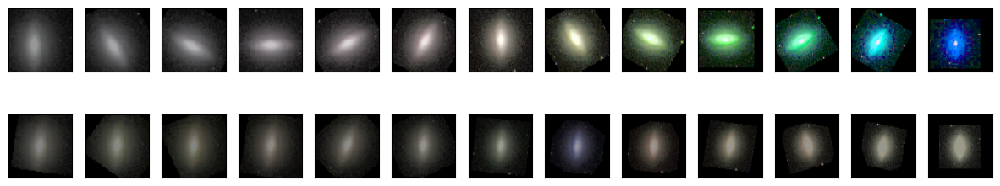

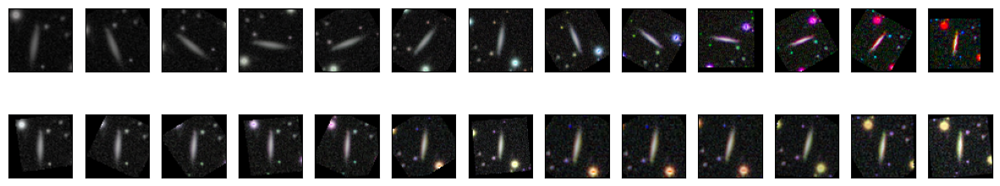

In [8]:
val_iter = deterministic_data.start_input_pipeline(val_ds)
val_batch = next(val_iter)

get_prototype = make_get_prototype_fn(
    inf_model,
    inf_final_state,
    rng,
    inf_model.transform,
    inf_config.get("transform_kwargs", None),
)

for i, (x_, mask) in enumerate(
    product(
        [
            val_batch["image"][0][14],
            val_batch["image"][0][12],
            # val_batch["image"][0][1],
            # val_batch["image"][0][4],
            # val_batch["image"][0][9],
        ],
        [
            # jnp.array([0, 0, 1, 0, 0]),
            # jnp.array([1, 1, 0, 0, 0]),
            jnp.array([1, 1, 1, 1, 1, 1, 1, 1]),
        ],
    )
):
    fig = plot_protos_and_recons(
        x_, jnp.array(inf_config.augment_bounds) * mask, inf_model.transform, get_prototype, inf_config.get("transform_kwargs", None),
    )
    try:
        run.summary[f"inf_plots_{i}"] = wandb.Image(fig)
    except:
        pass
    plt.show(fig)
    plt.close(fig)

## Train Gen

In [9]:
def prototype_function(x, rng):
    η = inf_model.apply(
        {"params": inf_final_state.params}, x, train=False
    ).sample(seed=rng)
    return η

In [10]:
rng = random.PRNGKey(gen_config.seed)
data_rng, init_rng = random.split(rng)

In [11]:
train_ds, val_ds, _ = get_data(gen_config, data_rng)
input_shape = train_ds.element_spec["image"].shape[2:]

INFO:absl:Load dataset info from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Reusing dataset galaxy_mnist (/homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0)
INFO:absl:Constructing tf.data.Dataset galaxy_mnist for split _EvenSplit(split='train[1000:]', index=0, count=1, drop_remainder=False), from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Features before preprocessing: {'image': 'uint8[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op ValueRange(vmin=-1, vmax=1, in_min=0, in_max=255.0, clip_values=False, key='image', key_result=None):
{'image': 'float32[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Resize(resize_size=64, method='bilinear', key='image', key_result=None):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Keep(keys=['image', 'label']):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Features after pr

In [12]:
gen_model = TransformationGenerativeNet(
    bounds=gen_config.get("augment_bounds", None),
    offset=gen_config.get("augment_offset", None),
    **gen_config.model.to_dict(),
)

gen_state = create_transformation_generative_state(
    gen_model,
    gen_config,
    init_rng,
    input_shape,
)

INFO:absl:
+----------------------------------------------+---------------+------------+-----------+---------+
| Name                                         | Shape         | Size       | Mean      | Std     |
+----------------------------------------------+---------------+------------+-----------+---------+
| params/Conditioner_0/Dense_0/bias            | (152,)        | 152        | 0.0       | 0.0     |
| params/Conditioner_0/Dense_0/kernel          | (256, 152)    | 38,912     | 0.0       | 0.0     |
| params/Conditioner_0/MLP_0/Dense_0/bias      | (256,)        | 256        | 0.0       | 0.0     |
| params/Conditioner_0/MLP_0/Dense_0/kernel    | (264, 256)    | 67,584     | 0.000256  | 0.0615  |
| params/Conditioner_0/MLP_0/LayerNorm_0/bias  | (256,)        | 256        | 0.0       | 0.0     |
| params/Conditioner_0/MLP_0/LayerNorm_0/scale | (256,)        | 256        | 1.0       | 0.0     |
| params/Conditioner_1/Dense_0/bias            | (152,)        | 152        | 0.0       |

In [13]:
gen_model_checkpoint_path = gen_config.get("checkpoint", "")
if (
    gen_model_checkpoint_path != ""
    and not Path(gen_model_checkpoint_path).exists()
):
    run = wandb.init(
        project="iclr2024experiments",
        entity="invariance-learners",
        config=gen_config.to_dict(),
        mode="offline",
        notes="",
        name=None,
        settings=wandb.Settings(code_dir="../"),
    )

    train_step, eval_step = make_transformation_generative_train_and_eval(
        gen_model, gen_config, prototype_function=prototype_function
    )

    gen_final_state, history, _ = ciclo.train_loop(
        gen_state,
        deterministic_data.start_input_pipeline(train_ds),
        {
            ciclo.on_train_step: [train_step],
            ciclo.on_reset_step: reset_metrics,
            ciclo.on_test_step: eval_step,
        },
        test_dataset=lambda: deterministic_data.start_input_pipeline(val_ds),
        epoch_duration=int(gen_config.steps * gen_config.eval_freq),
        callbacks=[
            ciclo.keras_bar(total=gen_config.steps),
        ],
        stop=gen_config.steps + 1,
    )

    save_checkpoint(gen_model_checkpoint_path, gen_final_state, gen_config)

    fig = plot_gen_model_training_metrics(history)
    run.summary[f"gen_training_metrics"] = wandb.Image(fig)
    plt.close(fig)

    run.finish()
else:
    gen_final_state, _ = load_checkpoint(
        gen_model_checkpoint_path, gen_state, gen_config
    )

INFO:absl:Loading model checkpoint from ckpts/gen_galaxy_both.
INFO:absl:Restoring item from ckpts/gen_galaxy_both.
INFO:absl:Finished restoring checkpoint from ckpts/gen_galaxy_both.
Loaded config:
augment_bounds:
- 0.25
- 0.25
- 3.141592653589793
- 0.25
- 0.25
- 0.5
- 2.31
- 0.51
augment_offset:
- 0.0
- 0.0
- 0.0
- 0.0
- 0.0
- 0.5
- 0.0
- 0.0
batch_size: 512
bounds_mult: 0.75
checkpoint: ckpts/gen_galaxy_both
clip_norm: 2.0
dataset: galaxy_mnist
eval_freq: 0.01
final_lr_mult: 0.3
init_lr_mult: 0.1
lr: 0.0003
mae_loss_mult: 1.0
model:
  conditioner:
    dropout_rate: 0.1
    hidden_dims:
    - 256
  dropout_rate: 0.05
  hidden_dims:
  - 1024
  - 512
  - 256
  num_bins: 6
  num_flows: 6
  squash_to_bounds: true
  transform: null
model_name: generative_net
n_samples: 5
num_val: 1000
pp_eval: value_range(-1, 1)|resize(64, "bilinear")|keep(["image", "label"])
pp_train: value_range(-1, 1)|resize(64, "bilinear")|keep(["image", "label"])
repeat_after_batching: true
seed: 0
shuffle: preproces

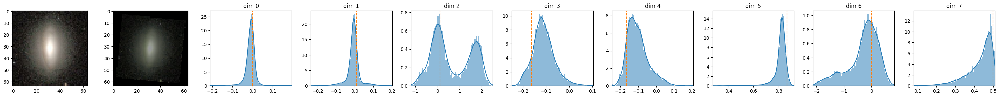

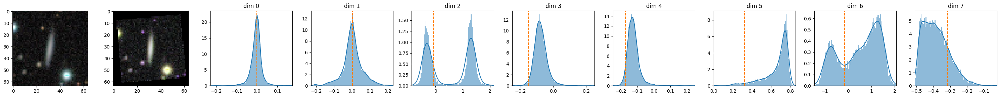

In [14]:
val_iter = deterministic_data.start_input_pipeline(val_ds)
val_batch = next(val_iter)
for i, x in enumerate(
    [
        val_batch["image"][0][14],
        val_batch["image"][0][12],
        # val_batch["image"][0][1],
        # val_batch["image"][0][4],
        # val_batch["image"][0][9],
    ]
):
    fig = plot_gen_dists(
        x,
        prototype_function,
        rng,
        gen_model,
        gen_final_state.params,
        gen_config,
    )
    try:
        run.summary[f"gen_plots_{i}"] = wandb.Image(fig)
    except:
        pass
    plt.show(fig)
    plt.close(fig)

## Train AUG-VAE

In [15]:
rng = random.PRNGKey(vae_config.seed)
data_rng, init_rng = random.split(rng, 2)

In [16]:
train_ds, val_ds, test_ds = get_data(vae_config, data_rng)
input_shape = train_ds.element_spec["image"].shape[2:]

INFO:absl:Load dataset info from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Reusing dataset galaxy_mnist (/homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0)
INFO:absl:Constructing tf.data.Dataset galaxy_mnist for split _EvenSplit(split='train[1000:]', index=0, count=1, drop_remainder=False), from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0


INFO:absl:Features before preprocessing: {'image': 'uint8[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op ValueRange(vmin=-1, vmax=1, in_min=0, in_max=255.0, clip_values=False, key='image', key_result=None):
{'image': 'float32[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Resize(resize_size=64, method='bilinear', key='image', key_result=None):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Keep(keys=['image', 'label']):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Features after preprocessing: {'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Constructing tf.data.Dataset galaxy_mnist for split _EvenSplit(split='train[:1000]', index=0, count=1, drop_remainder=False), from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Features before preprocessing: {'image': 'uint8[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}

In [17]:
vae_model = VAE(
    transform=gen_model.transform,
    transform_kwargs=gen_config.get("transform_kwargs", None),
    vae={**vae_config.model.to_dict(), "image_shape": input_shape},
    inference=inf_config.model.to_dict(),
    generative=gen_config.model.to_dict(),
    bounds=gen_config.get("augment_bounds", None),
    offset=gen_config.get("augment_offset", None),
)

vae_state = create_vae_state(
    vae_model,
    vae_config,
    init_rng,
    input_shape,
    inf_final_state,
    gen_final_state,
)

INFO:absl:
+---------------------------------------------------------------+------------------+------------+-----------+----------+
| Name                                                          | Shape            | Size       | Mean      | Std      |
+---------------------------------------------------------------+------------------+------------+-----------+----------+
| params/generative_model/Conditioner_0/Dense_0/bias            | (152,)           | 152        | 0.0       | 0.0      |
| params/generative_model/Conditioner_0/Dense_0/kernel          | (256, 152)       | 38,912     | 0.0       | 0.0      |
| params/generative_model/Conditioner_0/MLP_0/Dense_0/bias      | (256,)           | 256        | 0.0       | 0.0      |
| params/generative_model/Conditioner_0/MLP_0/Dense_0/kernel    | (264, 256)       | 67,584     | -0.000153 | 0.0618   |
| params/generative_model/Conditioner_0/MLP_0/LayerNorm_0/bias  | (256,)           | 256        | 0.0       | 0.0      |
| params/generative_m

In [18]:
train_step, eval_step = make_vae_train_and_eval(vae_model, vae_config)
x = next(deterministic_data.start_input_pipeline(val_ds))["image"][0]
reconstruction_plot, sampling_plot = make_vae_plotting_fns(
    vae_config, vae_model, x
)

2024-03-20 14:08:25.127156: W tensorflow/core/kernels/data/cache_dataset_ops.cc:854] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


    0/10000 [..............................] - ETA: 0s - elbo: -6974.8413 - iwlb: nan - kld: 0.0000e+00 - ll: -6974.8413 - loss: 6974.8413 - x_mse: 0.6601 - elbo_test: -6548.5771 - iwlb_test: nan - kld_test: 0.0138 - ll_test: -6548.5635 - loss_test: 6548.5771 - x_mse_test: 1.3012

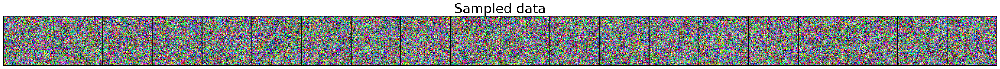

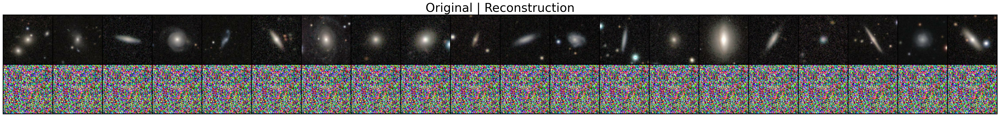

 2500/10000 [======>.......................] - ETA: 40:43 - elbo: 3655.1099 - iwlb: nan - kld: 40.9285 - ll: 3696.0374 - loss: -3655.1099 - x_mse: 0.0240 - elbo_test: 3822.2021 - iwlb_test: nan - kld_test: 41.5747 - ll_test: 3863.7766 - loss_test: -3822.2021 - x_mse_test: 0.0086   - ETA: 65:43:39 - elbo: -6288.1382 - iwlb: nan - kld: 0.0577 - ll: -6288.0796 - loss: 6288.1382 - x_mse: 1.1500 - elbo_test: -6548.5771 - iwlb_test: nan - kld_test: 0.0138 - ll_test: -6548.5635 - loss_test: 6548.5771 - x_mse_test: 1.30 - ETA: 49:29:42 - elbo: -6140.8584 - iwlb: nan - kld: 0.0999 - ll: -6140.7578 - loss: 6140.8584 - x_mse: 1.0803 - elbo_test: -6548.5771 - iwlb_test: nan - kld_test: 0.0138 - ll_test: -6548.5635 - loss_test: 6548.5771 - x_mse_test: 1.30 - ETA: 39:45:17 - elbo: -6000.7671 - iwlb: nan - kld: 0.1582 - ll: -6000.6079 - loss: 6000.7671 - x_mse: 1.0141 - elbo_test: -6548.5771 - iwlb_test: nan - kld_test: 0.0138 - ll_test: -6548.5635 - loss_test: 6548.5771 - x_mse_test: 1.30 - ETA: 33:

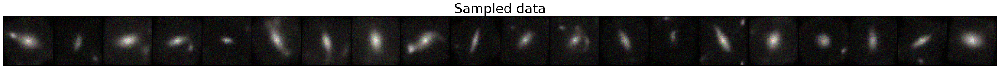

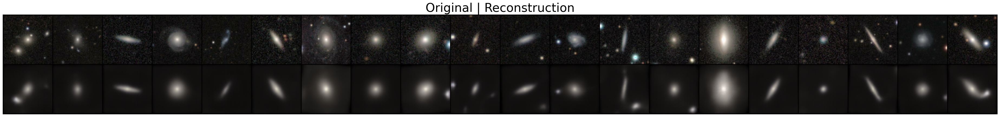

 5000/10000 [==============>...............] - ETA: 26:04 - elbo: 4083.3247 - iwlb: nan - kld: 47.9751 - ll: 4131.2993 - loss: -4083.3247 - x_mse: 0.0245 - elbo_test: 4052.3535 - iwlb_test: nan - kld_test: 48.9390 - ll_test: 4101.2925 - loss_test: -4052.3535 - x_mse_test: 0.0078- ETA: 40:58 - elbo: 3812.9028 - iwlb: nan - kld: 40.7535 - ll: 3853.6562 - loss: -3812.9028 - x_mse: 0.0244 - elbo_test: 3822.2021 - iwlb_test: nan - kld_test: 41.5747 - ll_test: 3863.7766 - loss_test: -3822.2021 - x_mse_test: 0.008 - ETA: 40:58 - elbo: 3781.8474 - iwlb: nan - kld: 40.8407 - ll: 3822.6880 - loss: -3781.8474 - x_mse: 0.0239 - elbo_test: 3822.2021 - iwlb_test: nan - kld_test: 41.5747 - ll_test: 3863.7766 - loss_test: -3822.2021 - x_mse_test: 0.008 - ETA: 40:57 - elbo: 3783.1807 - iwlb: nan - kld: 40.7747 - ll: 3823.9551 - loss: -3783.1807 - x_mse: 0.0233 - elbo_test: 3822.2021 - iwlb_test: nan - kld_test: 41.5747 - ll_test: 3863.7766 - loss_test: -3822.2021 - x_mse_test: 0.008 - ETA: 40:57 - elbo

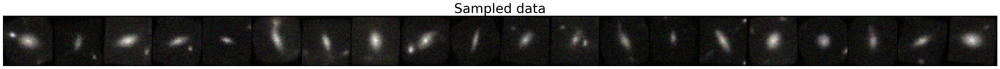

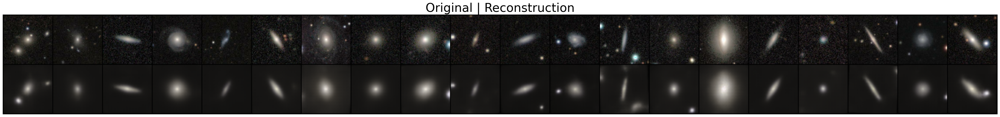

 7500/10000 [=====================>........] - ETA: 12:51 - elbo: 4181.8916 - iwlb: nan - kld: 49.9701 - ll: 4231.8623 - loss: -4181.8916 - x_mse: 0.0248 - elbo_test: 4177.9263 - iwlb_test: nan - kld_test: 50.1142 - ll_test: 4228.0400 - loss_test: -4177.9263 - x_mse_test: 0.0073- ETA: 26:08 - elbo: 4070.2939 - iwlb: nan - kld: 48.6605 - ll: 4118.9541 - loss: -4070.2939 - x_mse: 0.0253 - elbo_test: 4052.3535 - iwlb_test: nan - kld_test: 48.9390 - ll_test: 4101.2925 - loss_test: -4052.3535 - x_mse_test: 0.007 - ETA: 26:08 - elbo: 4069.0249 - iwlb: nan - kld: 48.3432 - ll: 4117.3682 - loss: -4069.0249 - x_mse: 0.0251 - elbo_test: 4052.3535 - iwlb_test: nan - kld_test: 48.9390 - ll_test: 4101.2925 - loss_test: -4052.3535 - x_mse_test: 0.007 - ETA: 26:08 - elbo: 4077.9375 - iwlb: nan - kld: 48.1949 - ll: 4126.1323 - loss: -4077.9375 - x_mse: 0.0248 - elbo_test: 4052.3535 - iwlb_test: nan - kld_test: 48.9390 - ll_test: 4101.2925 - loss_test: -4052.3535 - x_mse_test: 0.007 - ETA: 26:07 - elbo

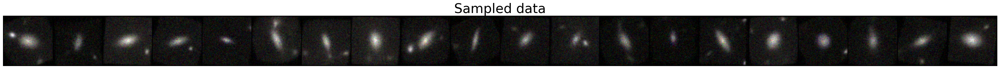

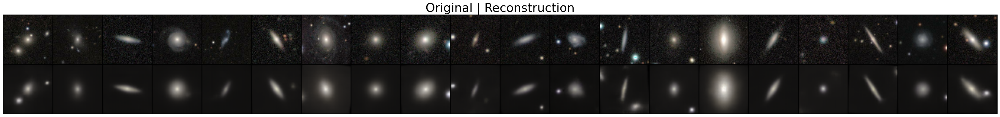

10000/10000 [==============================] - 3065s 306ms/step - elbo: 4218.7129 - iwlb: nan - kld: 50.7614 - ll: 4269.4751 - loss: -4218.7129 - x_mse: 0.0248 - elbo_test: 4193.3169 - iwlb_test: nan - kld_test: 51.1327 - ll_test: 4244.4492 - loss_test: -4193.3169 - x_mse_test: 0.0073 12:52 - elbo: 4221.6084 - iwlb: nan - kld: 49.7145 - ll: 4271.3232 - loss: -4221.6084 - x_mse: 0.0239 - elbo_test: 4177.9263 - iwlb_test: nan - kld_test: 50.1142 - ll_test: 4228.0400 - loss_test: -4177.9263 - x_mse_test: 0.007 - ETA: 12:52 - elbo: 4201.5122 - iwlb: nan - kld: 49.8417 - ll: 4251.3540 - loss: -4201.5122 - x_mse: 0.0243 - elbo_test: 4177.9263 - iwlb_test: nan - kld_test: 50.1142 - ll_test: 4228.0400 - loss_test: -4177.9263 - x_mse_test: 0.007 - ETA: 12:51 - elbo: 4185.3340 - iwlb: nan - kld: 49.8402 - ll: 4235.1748 - loss: -4185.3340 - x_mse: 0.0243 - elbo_test: 4177.9263 - iwlb_test: nan - kld_test: 50.1142 - ll_test: 4228.0400 - loss_test: -4177.9263 - x_mse_test: 0.007 - ETA: 12:51 - elbo

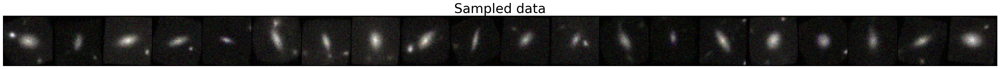

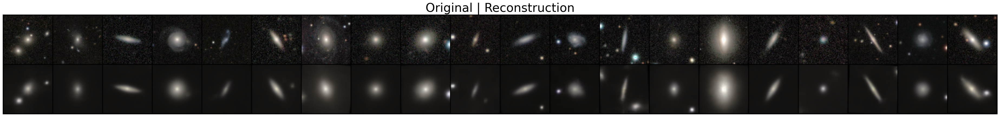

lr,▂▃▅▆██████▇▇▇▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
train/elbo,▁▁▂▄▅▆▇▇▇▇█▇████████████████████████████
train/kld,▁▁▁▁▂▂▃▄▆▆▇▇▇▇▇▇▇▇▇█████████████████████
train/ll,▁▁▂▄▅▆▇▇▇▇█▇████████████████████████████
train/loss,██▇▅▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train/x_mse,▃█▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃▃▃▄▃▃▄▄▄▄▄▃▄▄▄▄▄▄▄▄▄▄▄▄
valid/elbo,▁▃▄▅▆▆▇▇▇███████████████████████████████
valid/kld,▁▁▁▁▂▂▃▄▆▆▇▇▇▇▇▇██▇█████████████████████
valid/ll,▁▃▄▅▆▆▇▇▇███████████████████████████████
valid/loss,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
valid/x_mse,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [19]:
run = wandb.init(
    project="iclr2024experiments",
    entity="invariance-learners",
    config=vae_config.to_dict(),
    mode="offline",
    notes="",
    name=None,
    settings=wandb.Settings(code_dir="../"),
)

final_vae_state, history, _ = ciclo.train_loop(
    vae_state,
    deterministic_data.start_input_pipeline(train_ds),
    {
        ciclo.on_train_step: [train_step],
        ciclo.every(int(vae_config.steps * vae_config.plot_freq)): [
            sampling_plot,
            reconstruction_plot,
        ],
        ciclo.on_reset_step: reset_metrics,
        ciclo.on_test_step: [
            eval_step,
        ],
        ciclo.every(1): custom_wandb_logger(run=run),
    },
    test_dataset=lambda: deterministic_data.start_input_pipeline(val_ds),
    epoch_duration=int(vae_config.steps * vae_config.eval_freq),
    callbacks=[
        ciclo.keras_bar(total=vae_config.steps),
    ],
    stop=vae_config.steps + 1,
)

run.finish()

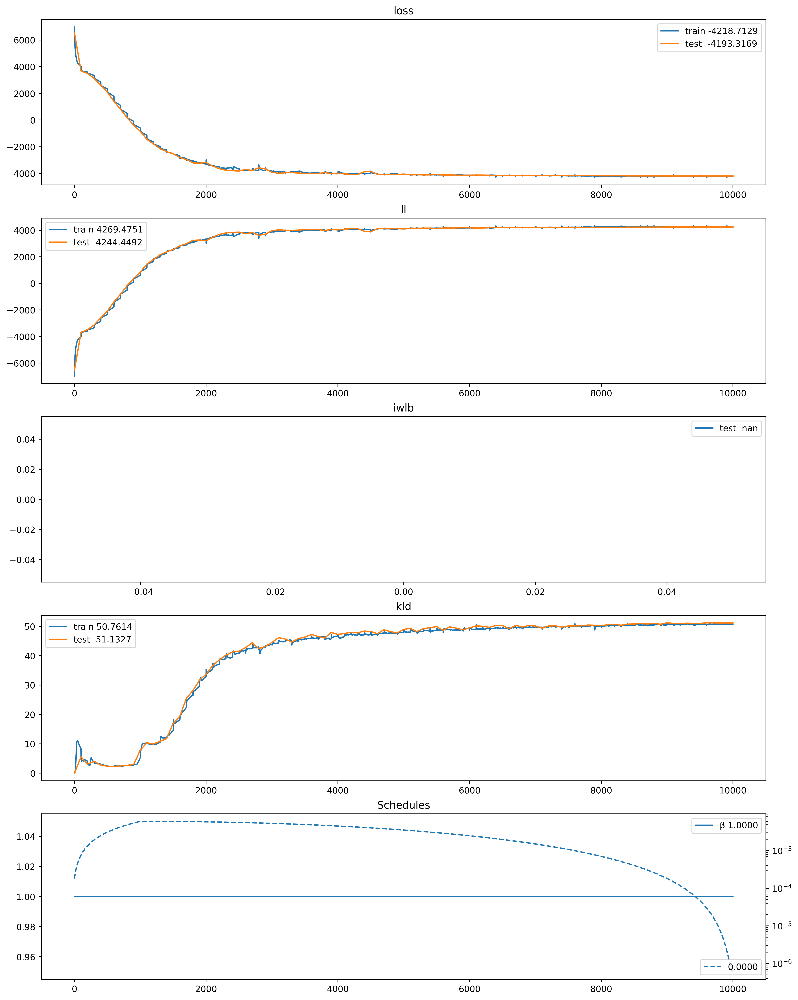

In [20]:
# plot the training history
steps, loss, elbo, ll, kld, lr, β = history.collect(
    "steps", "loss", "elbo", "ll", "kld", "lr", "β"
)
steps_test, loss_test, elbo_test, ll_test, kld_test, iwlb_test = history.collect(
    "steps", "loss_test", "elbo_test", "ll_test", "kld_test", "iwlb_test"
)

n_plots = 5
fig, axs = plt.subplots(n_plots, 1, figsize=(15, 4 * n_plots), dpi=400)

axs[0].plot(steps, loss, label=f"train {loss[-1]:.4f}")
axs[0].plot(steps_test, loss_test, label=f"test  {loss_test[-1]:.4f}")
axs[0].legend()
axs[0].set_title("loss")

axs[1].plot(steps, ll, label=f"train {ll[-1]:.4f}")
axs[1].plot(steps_test, ll_test, label=f"test  {ll_test[-1]:.4f}")
axs[1].legend()
axs[1].set_title("ll")

axs[2].plot(steps_test, iwlb_test, label=f"test  {iwlb_test[-1]:.4f}")
axs[2].legend()
axs[2].set_title("iwlb")

axs[3].plot(steps, kld, label=f"train {kld[-1]:.4f}")
axs[3].plot(steps_test, kld_test, label=f"test  {kld_test[-1]:.4f}")
axs[3].legend()
axs[3].set_title("kld")

axs[4].plot(steps, β, label=f"β {β[-1]:.4f}")
axs[4].legend()
axs[4].set_title("Schedules")

ax4_twin = axs[4].twinx()
ax4_twin.plot(steps, lr, "--", label=f"{lr[-1]:.4f}")
ax4_twin.legend(loc="lower right")
ax4_twin.set_yscale("log")

plt.show()

In [25]:
vae_config_test = vae_config.copy_and_resolve_references()
vae_config_test.run_iwlb = True
vae_config_test.test_split = "test"
vae_config_test.batch_size_eval = 8

_, _, test_ds = get_data(vae_config_test, data_rng)
_, test_step = make_vae_train_and_eval(vae_model, vae_config_test)

_, test_history, _ = ciclo.test_loop(
    final_vae_state,
    deterministic_data.start_input_pipeline(test_ds),
    {
        ciclo.on_reset_step: reset_metrics,
        ciclo.on_test_step: [
            test_step,
        ],
    },
)

INFO:absl:Load dataset info from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Reusing dataset galaxy_mnist (/homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0)
INFO:absl:Constructing tf.data.Dataset galaxy_mnist for split _EvenSplit(split='train[1000:]', index=0, count=1, drop_remainder=False), from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Features before preprocessing: {'image': 'uint8[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op ValueRange(vmin=-1, vmax=1, in_min=0, in_max=255.0, clip_values=False, key='image', key_result=None):
{'image': 'float32[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Resize(resize_size=64, method='bilinear', key='image', key_result=None):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Keep(keys=['image', 'label']):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Features after pr

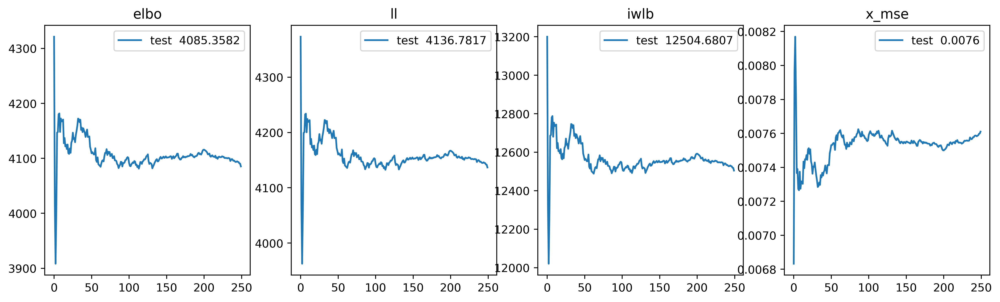

In [26]:
# make a plot of the test history (specifically the ELBO, ll, iwlb)
steps, elbo, ll, iwlb, x_mse = test_history.collect("steps", "elbo", "ll", "iwlb", "x_mse")

fig, axs = plt.subplots(1, 4, figsize=(15, 4), dpi=400)

axs[0].plot(steps, elbo, label=f"test  {elbo[-1]:.4f}")
axs[0].legend()
axs[0].set_title("elbo")

axs[1].plot(steps, ll, label=f"test  {ll[-1]:.4f}")
axs[1].legend()
axs[1].set_title("ll")

axs[2].plot(steps, iwlb, label=f"test  {iwlb[-1]:.4f}")
axs[2].legend()
axs[2].set_title("iwlb")

axs[3].plot(steps, x_mse, label=f"test  {x_mse[-1]:.4f}")
axs[3].legend()
axs[3].set_title("x_mse")

plt.show()